# Исследование объявлений о продаже квартир

В вашем распоряжении данные сервиса Яндекс.Недвижимость — архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктов за несколько лет. Нужно научиться определять рыночную стоимость объектов недвижимости. Ваша задача — установить параметры. Это позволит построить автоматизированную систему: она отследит аномалии и мошенническую деятельность. 

По каждой квартире на продажу доступны два вида данных. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта, ближайшего парка и водоёма. 

### Шаг 1. Откройте файл с данными и изучите общую информацию. 

In [1]:
import pandas as pd
# import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
data = pd.read_csv('/ds_praktikum_real_estate_data/real_estate_data.csv', sep='\t')
data.head()

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07T00:00:00,3,2.70,16.0,51.0,8,NaN,...,25.0,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04T00:00:00,1,NaN,11.0,18.6,1,NaN,...,11.0,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20T00:00:00,2,NaN,5.0,34.3,4,NaN,...,8.3,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,...,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19T00:00:00,2,3.03,14.0,32.0,13,NaN,...,41.0,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   

In [4]:
data.describe()

,total_images,last_price,total_area,rooms,ceiling_height,floors_total,living_area,floor,kitchen_area,balcony,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
count,23699.000000,2.369900e+04,23699.000000,23699.000000,14504.000000,23613.000000,21796.000000,23699.000000,21421.000000,12180.000000,18157.000000,18180.000000,18181.000000,8079.000000,18181.000000,9110.000000,20518.000000
mean,9.858475,6.541549e+06,60.348651,2.070636,2.771499,10.673824,34.457852,5.892358,10.569807,1.150082,28793.672193,14191.277833,0.611408,490.804555,0.770255,517.980900,180.888634
std,5.682529,1.088701e+07,35.654083,1.078405,1.261056,6.597173,22.030445,4.885249,5.905438,1.071300,12630.880622,8608.386210,0.802074,342.317995,0.938346,277.720643,219.727988
min,0.000000,1.219000e+04,12.000000,0.000000,1.000000,1.000000,2.000000,1.000000,1.300000,0.000000,0.000000,181.000000,0.000000,1.000000,0.000000,13.000000,1.000000
25%,6.000000,3.400000e+06,40.000000,1.000000,2.520000,5.000000,18.600000,2.000000,7.000000,0.000000,18585.000000,9238.000000,0.000000,288.000000,0.000000,294.000000,45.000000
50%,9.000000,4.650000e+06,52.000000,2.000000,2.650000,9.000000,30.000000,4.000000,9.100000,1.000000,26726.000000,13098.500000,0.000000,455.000000,1.000000,502.000000,95.000000
75%,14.000000,6.800000e+06,69.900000,3.000000,2.800000,16.000000,42.300000,8.000000,12.000000,2.000000,37273.000000,16293.000000,1.000000,612.000000,1.000000,729.000000,232.000000
max,50.000000,7.630000e+08,900.000000,19.000000,100.000000,60.000000,409.700000,33.000000,112.000000,5.000000,84869.000000,65968.000000,3.000000,3190.000000,3.000000,1344.000000,1580.000000


### Вывод

Можно сразу сказать, что пропусков у нас достаточно, чтобы их не игнорировать. Сейчас нужно постараться заполнить пропуски\
корректными значениями с наименьшей потерей данных. Особенно много пропусков в столбцах, которые заполнены автоматически.\
Эти пропуски не случайны, да и в остальных стобцах более-менее данные есть, поэтому избавляться от строк с пропусками я не буду.\
Скорее всего, перед исследованием, их придётся как-то фильтровать. 

### Шаг 2. Предобработка данных

In [5]:
data.isna().sum(axis=0).sort_values(ascending=False) / len(data)

is_apartment            0.882906
parks_nearest           0.659100
ponds_nearest           0.615596
balcony                 0.486054
ceiling_height          0.387991
airports_nearest        0.233850
cityCenters_nearest     0.232879
parks_around3000        0.232837
ponds_around3000        0.232837
days_exposition         0.134225
kitchen_area            0.096122
living_area             0.080299
floors_total            0.003629
locality_name           0.002068
first_day_exposition    0.000000
last_price              0.000000
total_area              0.000000
studio                  0.000000
rooms                   0.000000
floor                   0.000000
open_plan               0.000000
total_images            0.000000
dtype: float64

In [6]:
data['is_apartment'].unique()
data['is_apartment'].isna().sum()
data['is_apartment'] = data['is_apartment'].fillna(False)

In [7]:
data['floors_total'].isna().sum()
floors_total_median = data['floors_total'].median()
data['floors_total'] = data['floors_total'].fillna(floors_total_median)

In [8]:
data['living_area'].isna().sum()
living_area_median = data['living_area'].median()
data['living_area'] = data['living_area'].fillna(living_area_median)

In [9]:
data['kitchen_area'].isna().sum()
kitchen_area_median = data['kitchen_area'].median()
data['kitchen_area'] = data['kitchen_area'].fillna(kitchen_area_median)

In [10]:
data['ceiling_height'].isna().sum()
ceiling_height_median = data['ceiling_height'].median()
data['ceiling_height'] = data['ceiling_height'].fillna(ceiling_height_median)

In [11]:
data['days_exposition'].isna().sum()
days_exposition_median = data['days_exposition'].median()
data['days_exposition'] = data['days_exposition'].fillna(days_exposition_median)

### Вывод

- ##### Можно заменить медианой
Решил разделить столбцы на некие "категории", сейчас это те, пропуски в которых можно, на мой взгляд, заполнить медианой по столбцам\
Если посмотреть на .value_counts() по каждому столбцу, можно увидеть, что средние значения будут близки к тем, что уже находятся в базе

In [12]:
data['balcony'].isna().sum()
data['balcony'].unique()
data['balcony'] = data['balcony'].fillna(0)

In [13]:
data['locality_name'].isna().sum()
data['locality_name'] = data['locality_name'].fillna('Санкт-Петербург')

In [14]:
data['parks_around3000'].unique()
data['parks_around3000'].isna().sum()
data['parks_around3000'] = data['parks_around3000'].fillna(-1)

In [15]:
data['ponds_around3000'].unique()
data['ponds_around3000'].isna().sum()
data['ponds_around3000'] = data['ponds_around3000'].fillna(-1)

In [16]:
data['parks_nearest'].isna().sum()
data['parks_nearest'] = data['parks_nearest'].fillna(-1)

In [17]:
data['ponds_nearest'].isna().sum()
data['ponds_nearest'] = data['ponds_nearest'].fillna(-1)

In [18]:
data['airports_nearest'].isna().sum()
data['airports_nearest'] = data['airports_nearest'].fillna(-1)

In [19]:
data['cityCenters_nearest'].isna().sum()
data['cityCenters_nearest'] = data['cityCenters_nearest'].fillna(-1)

### Вывод

- ##### Данные, которые получены автоматически
Всё, что пришло в голову - заполнить пропуски -1, по такому значению можно будет фильтровать данные перед исследованием.\
Заполнять медианой или средним значением по выборке я думаю не имеет смысла, такое действие негативно повлияет на исследование.

In [20]:
data['parks_around3000'] = data['parks_around3000'].astype('int64')
data['ponds_around3000'] = data['ponds_around3000'].astype('int64')
data['parks_nearest'] = data['parks_nearest'].astype('int64')
data['ponds_nearest'] = data['ponds_nearest'].astype('int64')
data['airports_nearest'] = data['airports_nearest'].astype('int64')
data['cityCenters_nearest'] = data['cityCenters_nearest'].astype('int64')

In [21]:
data.isna().sum(axis=0).sort_values(ascending=False) / len(data)

days_exposition         0.0
ponds_nearest           0.0
last_price              0.0
total_area              0.0
first_day_exposition    0.0
rooms                   0.0
ceiling_height          0.0
floors_total            0.0
living_area             0.0
floor                   0.0
is_apartment            0.0
studio                  0.0
open_plan               0.0
kitchen_area            0.0
balcony                 0.0
locality_name           0.0
airports_nearest        0.0
cityCenters_nearest     0.0
parks_around3000        0.0
parks_nearest           0.0
ponds_around3000        0.0
total_images            0.0
dtype: float64

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        23699 non-null  float64
 6   floors_total          23699 non-null  float64
 7   living_area           23699 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          23699 non-null  bool   
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          23699 non-null  float64
 13  balcony               23699 non-null  float64
 14  locality_name         23699 non-null  object 
 15  airports_nearest   

In [23]:
data.duplicated().sum()

0

In [24]:
data['last_price'] = data['last_price'].astype('int64')
data['floors_total'] = data['floors_total'].astype('int64')
data['living_area'] = round(data['living_area'])
data['living_area'] = data['living_area'].astype('int64')
data['kitchen_area'] = round(data['kitchen_area'])
data['kitchen_area'] = data['kitchen_area'].astype('int64')
data['balcony'] = data['balcony'].astype('int64')
data['days_exposition'] = data['days_exposition'].astype('int64')
data['total_area'] = round(data['total_area'])
data['total_area'] = data['total_area'].astype('int64')

In [25]:
data['locality_name'] = data['locality_name'].str.lower()

In [26]:
data['first_day_exposition'] = pd.to_datetime(data['first_day_exposition'], format='%Y.%m.%dT%H:%M:%S')

In [27]:
def map_name_func(i):
    '''
    Функция разделения объектов находящиеся в Санкт-Петербурге и Ленинградской области.
    '''
    for word in i.split(' '): 
        if 'санкт' in word:   
            return 'санкт-петербург'
        else:
            return 'ленинградская область'

In [28]:
data['map_location'] = data['locality_name'].apply(map_name_func)

### Шаг 3. Посчитайте и добавьте в таблицу

In [30]:
data['metres_price'] = data['last_price'] // data['total_area']

In [31]:
data['weekday_n'] = data['first_day_exposition'].dt.dayofweek

In [32]:
data['month_n'] = pd.DatetimeIndex(data['first_day_exposition']).month

In [33]:
data['year_first_exposition'] = pd.DatetimeIndex(data['first_day_exposition']).year

In [34]:
def floor_func(row):
    if row['floor'] == 1:
        return 'первый'  
    elif row['floor'] == row['floors_total']:
        return 'последний'
    else:
        return 'другой'

In [35]:
data['floor_group'] = data.apply(floor_func, axis=1)

In [36]:
data['living_area_percent'] = round(data['living_area'] / data['total_area'] * 100)
data['living_area_percent'] = data['living_area_percent'].astype('int64')

In [37]:
data['kitchen_area_percent'] = round(data['kitchen_area'] / data['total_area'] * 100)
data['kitchen_area_percent'] = data['kitchen_area_percent'].astype('int64')

### Шаг 4. Проведите исследовательский анализ данных и выполните инструкции:

In [39]:
hist_columns = data[['total_area', 'last_price', 'rooms', 'ceiling_height', 'days_exposition', 'metres_price']]

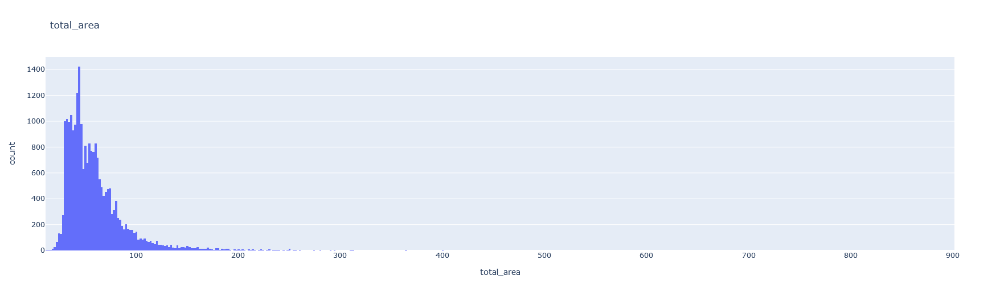

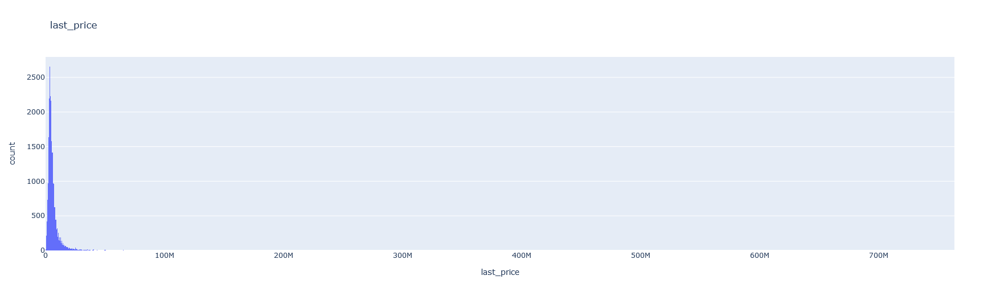

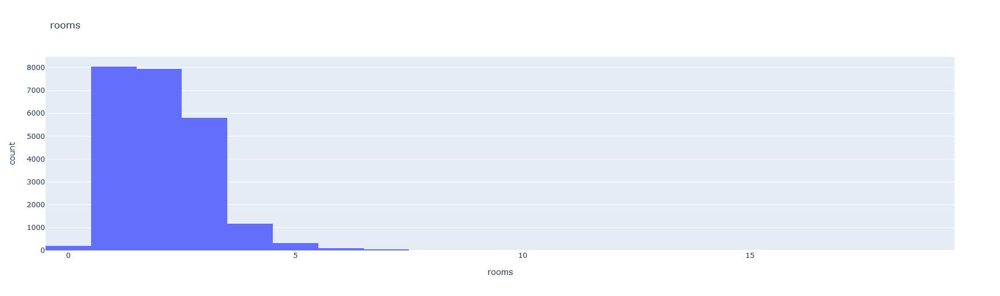

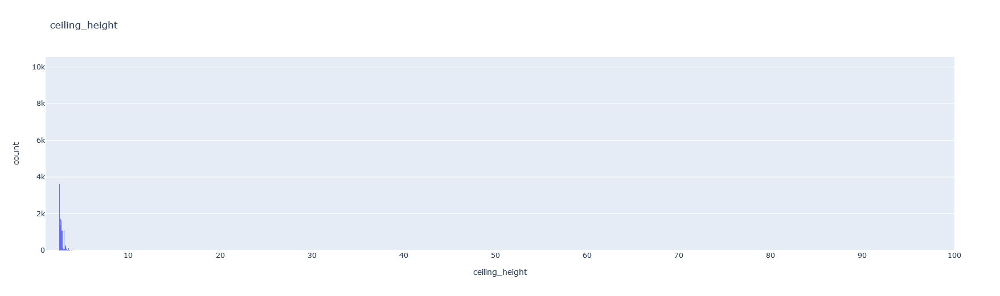

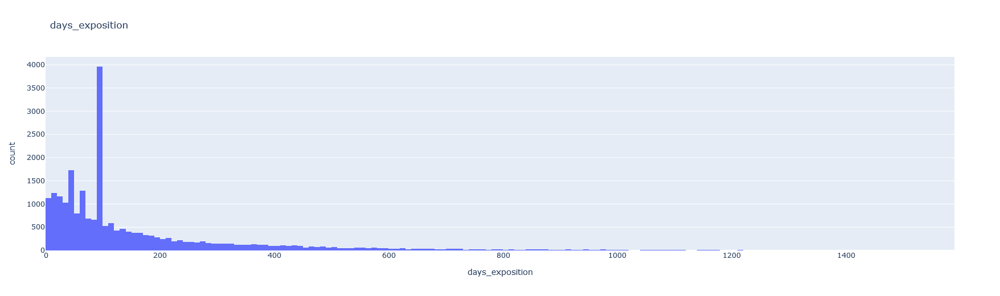

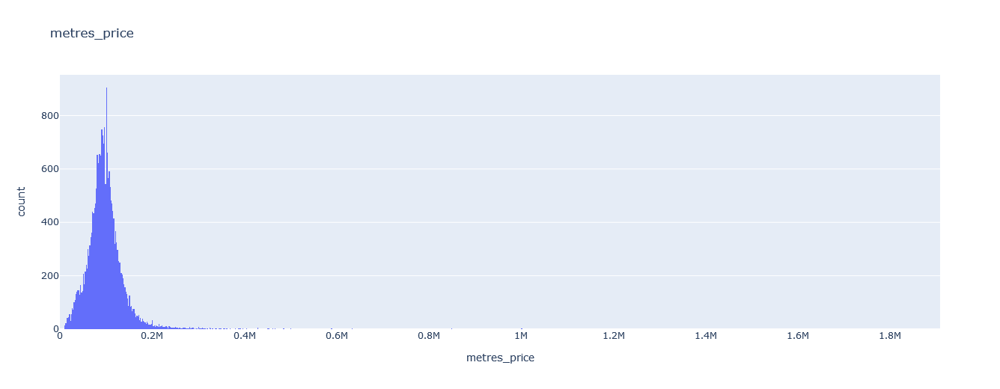

In [40]:
for row in hist_columns:
    fig = px.histogram(data, x=row, title=row, width=720, height=520)
    fig.show()

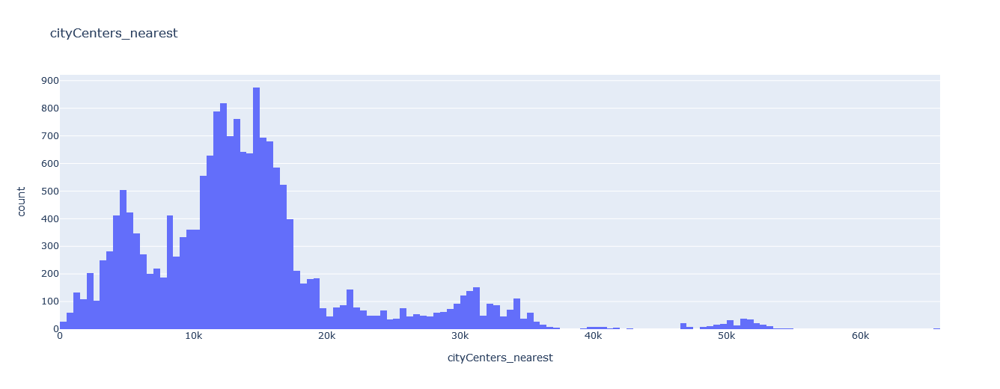

In [41]:
fig = px.histogram(data.query('-1 < cityCenters_nearest'), x='cityCenters_nearest', title='cityCenters_nearest', width=720,height=520)
fig.show()

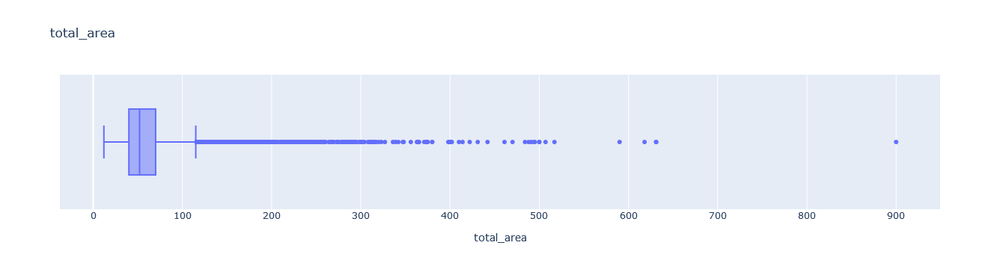

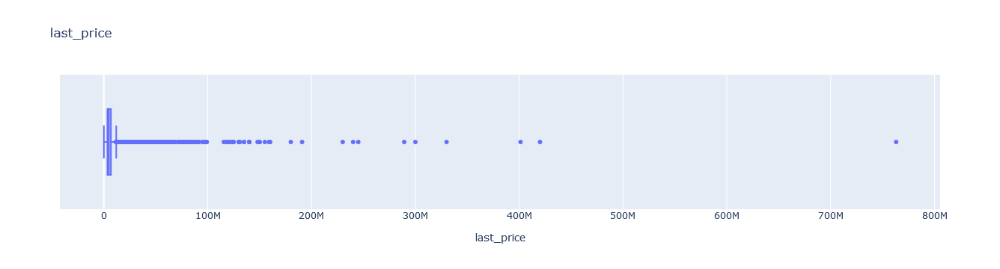

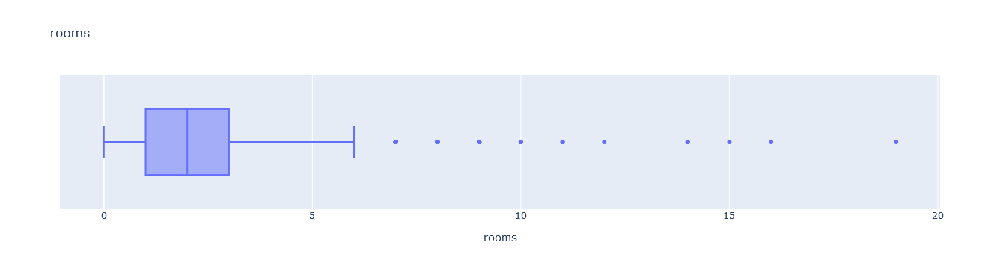

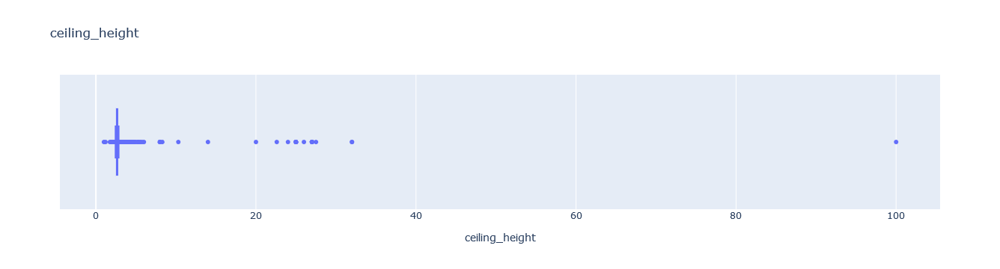

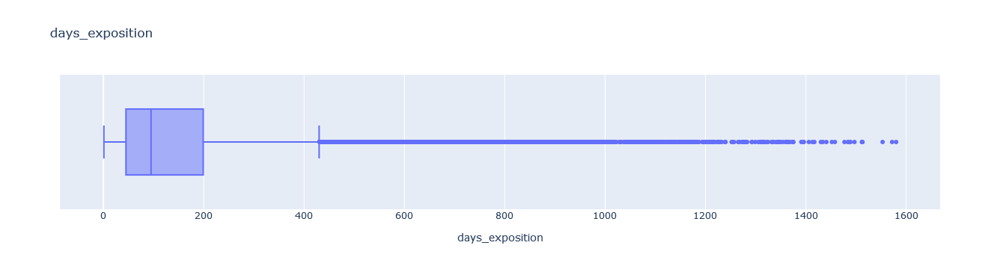

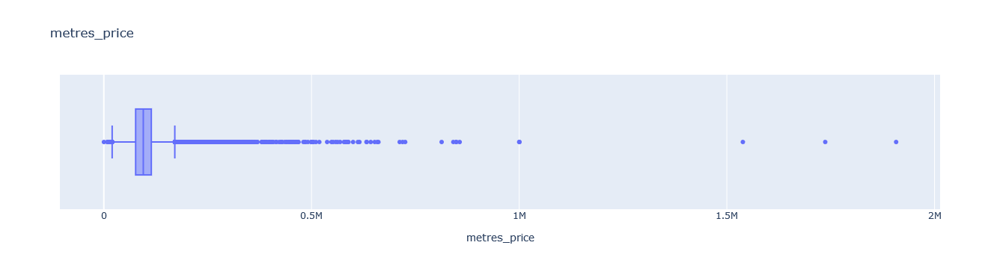

In [42]:
for row in hist_columns:
    fig = px.box(data, x=row, title=row, width=720,height=360)
    fig.show()

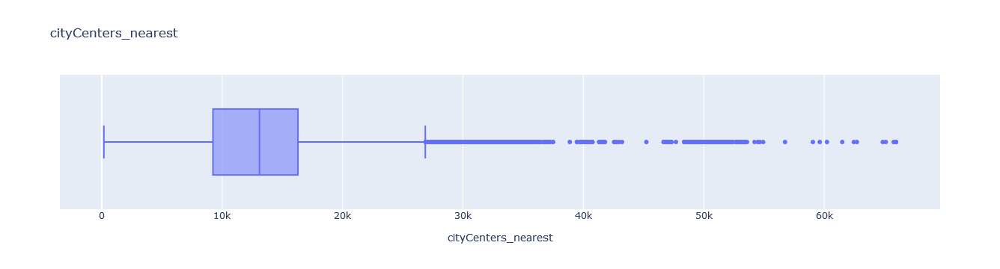

In [43]:
fig = px.box(data.query('-1 < cityCenters_nearest'), x='cityCenters_nearest', title='cityCenters_nearest', width=720,height=360)
fig.show()

In [44]:
days_sale_pivot_table = data.pivot_table(index=['map_location'], values='days_exposition', aggfunc=['mean', 'median'])
days_sale_pivot_table

,mean,median
,days_exposition,days_exposition
map_location,,
ленинградская область,165.381889,95
санкт-петербург,171.360495,95


In [45]:
days_sale_mean_median = data['days_exposition'].agg({'mean', 'median'})
days_sale_mean_median

mean      169.360226
median     95.000000
Name: days_exposition, dtype: float64

### Вывод

- ##### По нынешним графикам и таблицам можем наблюдать следующее:
Обычное время для продажи находится в районе от 60 до 200 дней. Именно в этот период, если верить гистограмме, продаётся большинство объектов.\
Далее от 250 дней колличество продаваемых объектов идёт на спад и продолжается до 1500 дней, что, несомненно, необычно долго.\
Необычайно быстрым сроком продаж, предполагаю, можно считать до 60 дней. Если посмотреть на диаграмму, примерно такое значение оно будет нам показывать.\
Необычайно долгое время продажи объекта, полагаю, можно считать от 500 дней. Таких объектов становится меньше и график тянется до 1500 дней продаж.

In [46]:
normal_data = data.query('total_area < 600 & 1_000_000 < last_price < 200_000_000 & 0 < rooms & 2.3 < ceiling_height < 5 & 30_000 < metres_price')

In [47]:
(data.shape[0]-normal_data.shape[0])/data.shape[0]

0.03181568842567197

### Вывод

- ##### Особенности
В наших данных были не совсем "правдивые" значения, которых точно нельзя брать с собой в приключение под названием "исследование"\
Были выделены основные стаки данных, которые были добавлены в новую переменую путём среза данных из основного датафрейма.\
Так например мы избавились от помещений высотой 1м., и от космически дорогих квартир, которые по своей особенной цене выбиваются\
из основного графика.

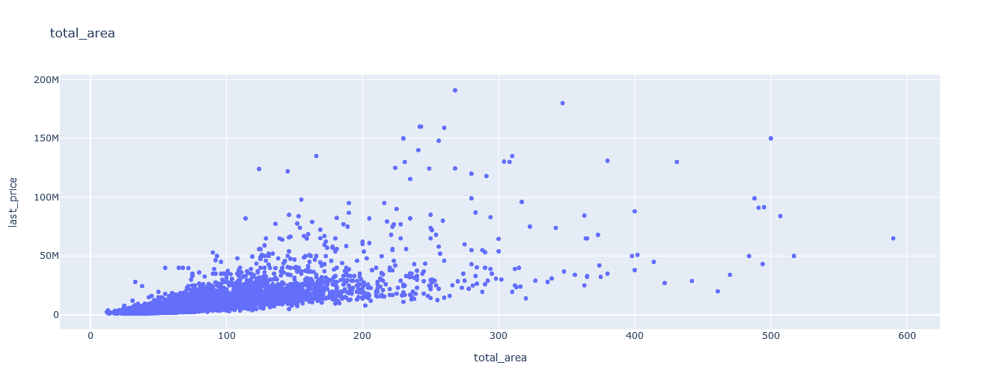

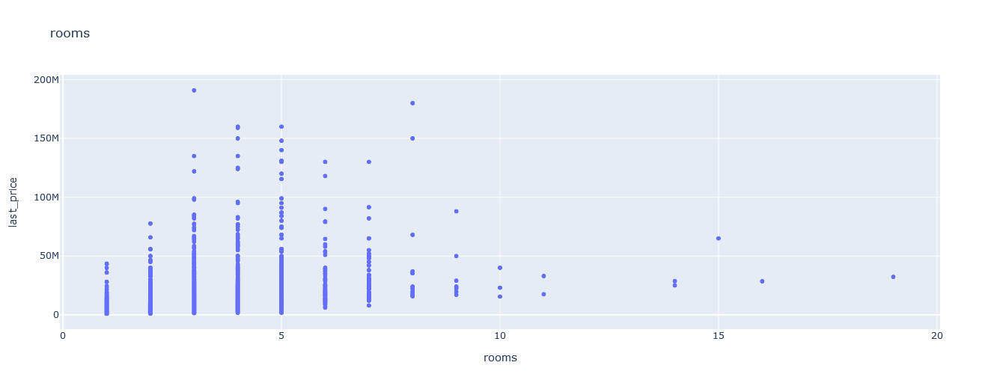

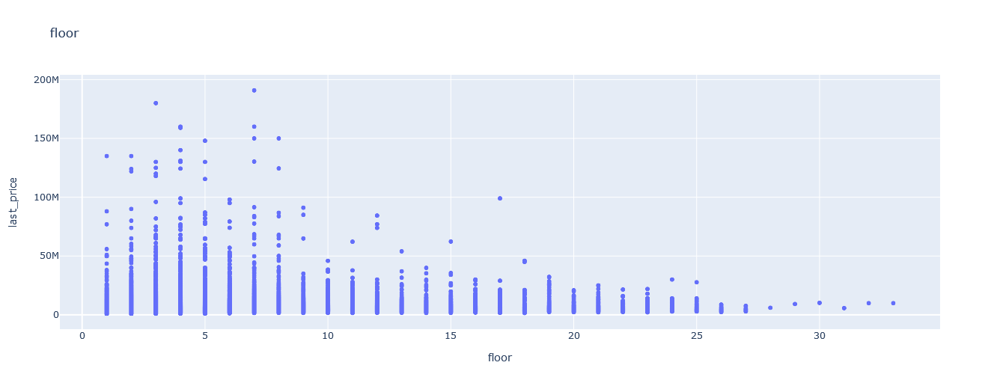

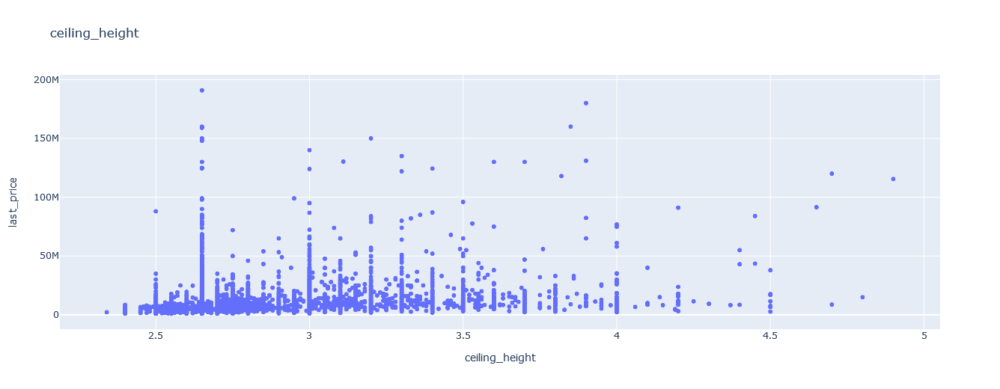

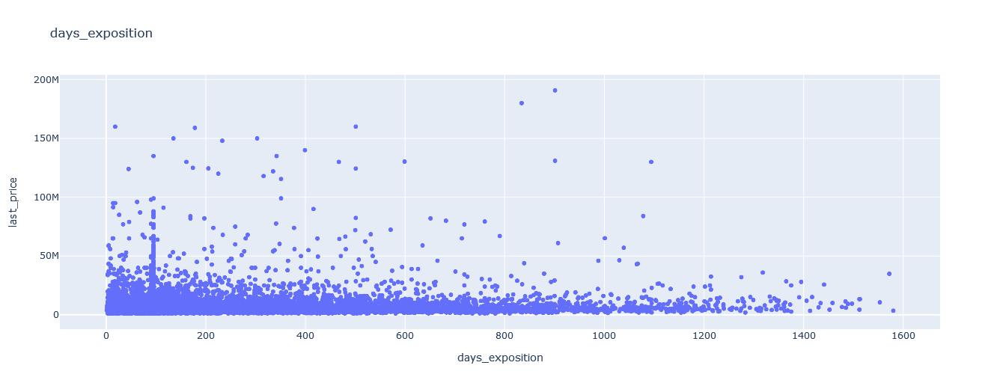

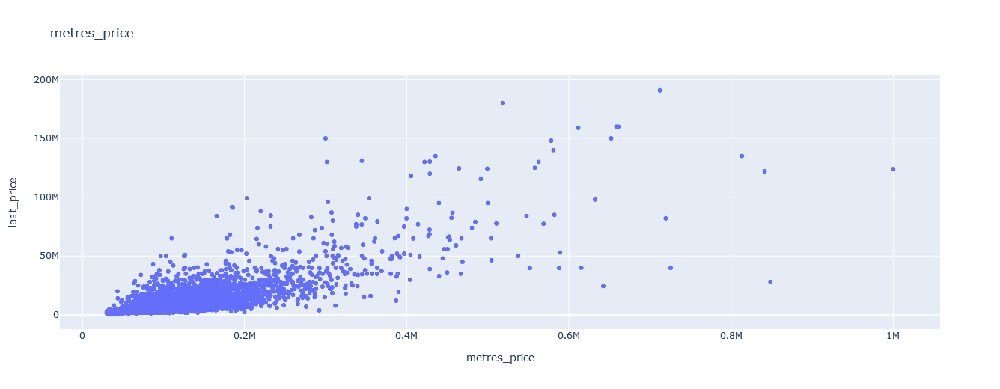

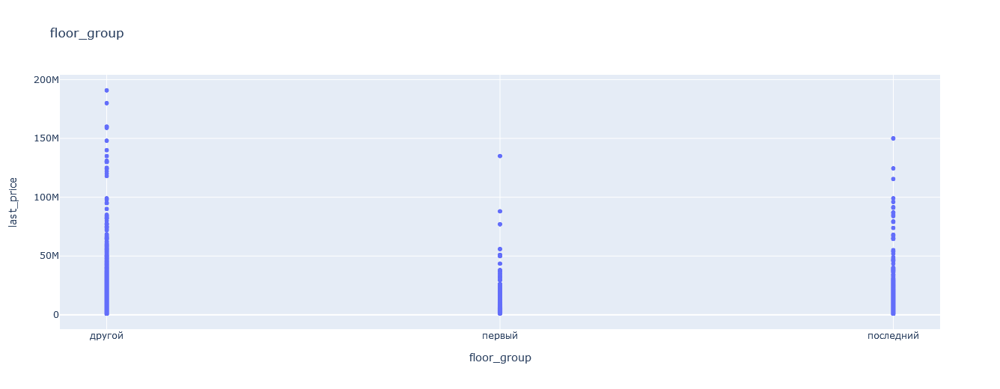

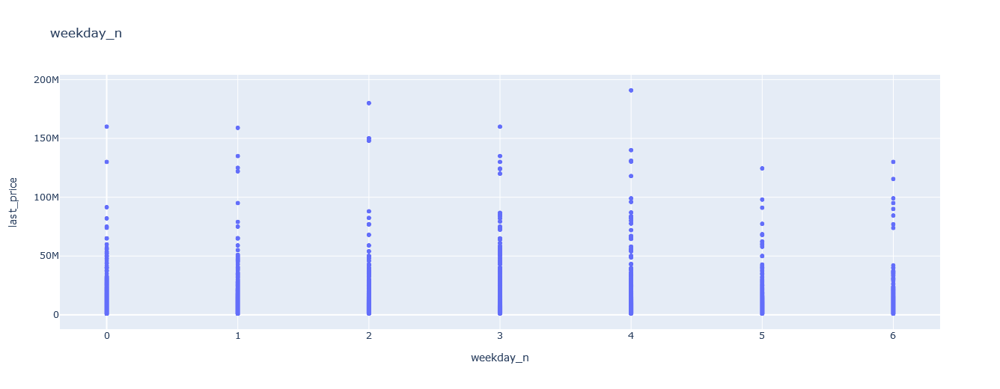

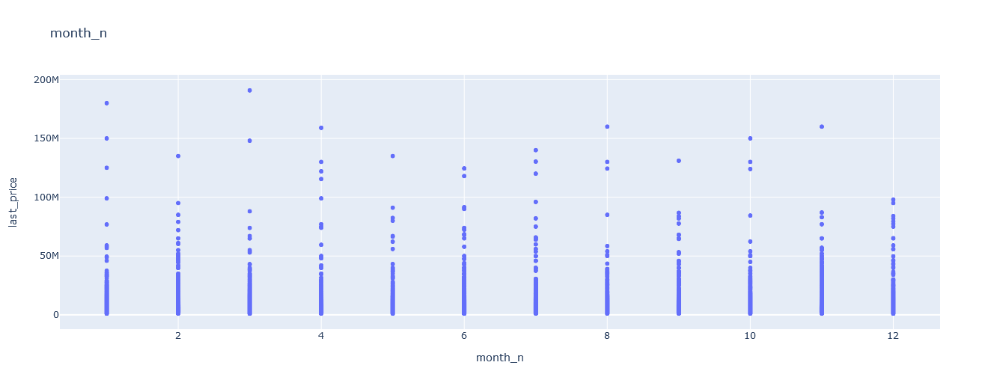

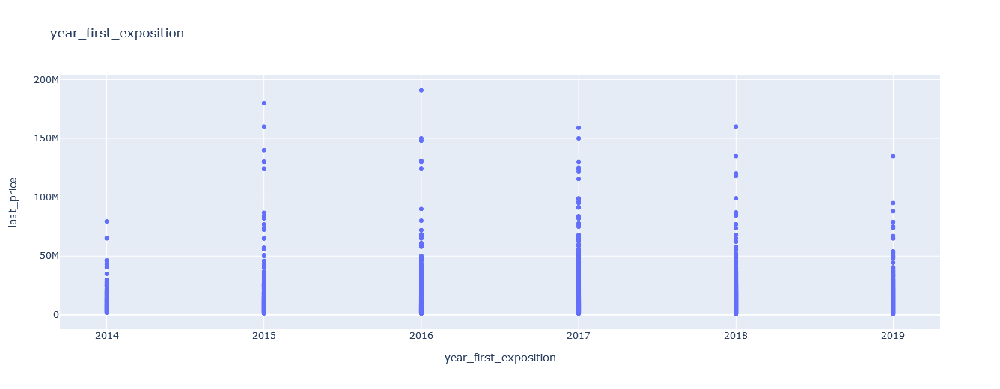

In [48]:
x_hist = normal_data[['total_area', 'rooms','floor', 'ceiling_height', 'days_exposition', 'metres_price', 'floor_group', 'weekday_n', 'month_n', 'year_first_exposition']]
for row in x_hist:    
    fig = px.scatter(normal_data, x=row, y='last_price', title=row, width=720,height=520)
    fig.show()

### Вывод

- ##### Зависимость
На этом графике видно, что цена за кв.м. влияент на итоговую цену объекта. Если посмотреть на график район периода до 65 тыс. р. за кв.м.\
то мы не заметим объектов, стоимость которых превышает 7.500 тыс. р., а вот уже ближе к 100 тыс. р. за кв. м. общая стоимость объекта начинает значтельно расти.\
Хочу отметить, что цена за кв. м. влияет на финальное ценообразование объекта, но не формирует его полность =)\
В остальных случаях я не заметил никакой зависимости на финальное ценообразование. Ниже будет график растояния до центра и вывод к нему

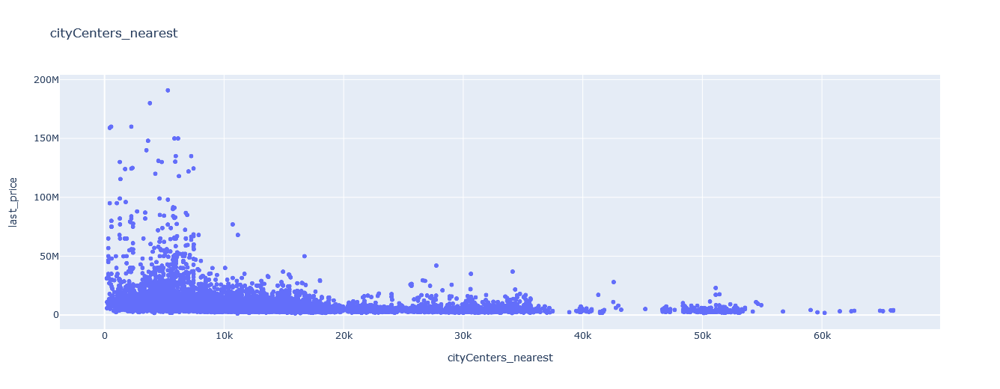

In [49]:
fig = px.scatter(normal_data.query('-1 < cityCenters_nearest'), x='cityCenters_nearest', y='last_price', title='cityCenters_nearest', width=720,height=520)
fig.show()

In [50]:
normal_data.query('-1 < cityCenters_nearest')['cityCenters_nearest'].corr(normal_data['last_price'])

-0.27209545911847227

### Общий вывод

Сейчас основными критериями финального ценообразования проекта являются: общая площадь, цена за квадратный метр, расстояние до центра, этаж объекта.\
Можно сказать, что остальные факторы, такие как: день публикации не влияют на финальное ценообразование объекта.\
Так же, чем ближе мы приближаемся к центру - растёт цена квадратного метра и увеличивается количество дорогостоящих объектов, есть зависимость.

In [51]:
normal_data['locality_name'].value_counts().head(10)

санкт-петербург      15612
посёлок мурино         494
посёлок шушары         436
всеволожск             390
пушкин                 369
колпино                338
посёлок парголово      323
гатчина                302
деревня кудрово        283
выборг                 228
Name: locality_name, dtype: int64

In [52]:
top_10_locations = normal_data.query('locality_name in ("санкт-петербург", "посёлок мурино", "посёлок шушары", "всеволожск", "пушкин", "колпино", "посёлок парголово", "гатчина", "деревня кудрово", "выборг")')

In [53]:
top_10_metres_price_mean = top_10_locations['metres_price'].mean()
top_10_metres_price_mean

108600.23898801598

In [54]:
top_10_locations_pivot = top_10_locations.pivot_table(index=['locality_name'], values='metres_price')
top_10_locations_pivot.sort_values(by=['metres_price'], ascending=True)

,metres_price
locality_name,
выборг,59231.346491
всеволожск,68740.376923
гатчина,69421.023179
колпино,75448.059172
посёлок шушары,78408.928899
посёлок мурино,85078.621457
посёлок парголово,90287.684211
деревня кудрово,92319.674912
пушкин,103170.219512


In [55]:
st_petersburg = normal_data.query('locality_name == "санкт-петербург"')

In [56]:
st_petersburg['to_center_km'] = round(st_petersburg['cityCenters_nearest'] // 1000)

<ipython-input-56-291c7a5bde74>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [57]:
st_petersburg['mean_price_km'] = st_petersburg['last_price'] // st_petersburg['to_center_km']

<ipython-input-57-5c148bfd3a8f>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



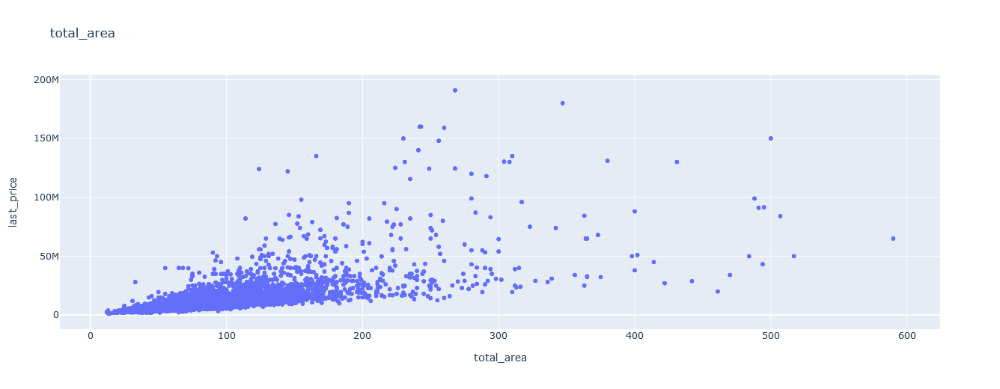

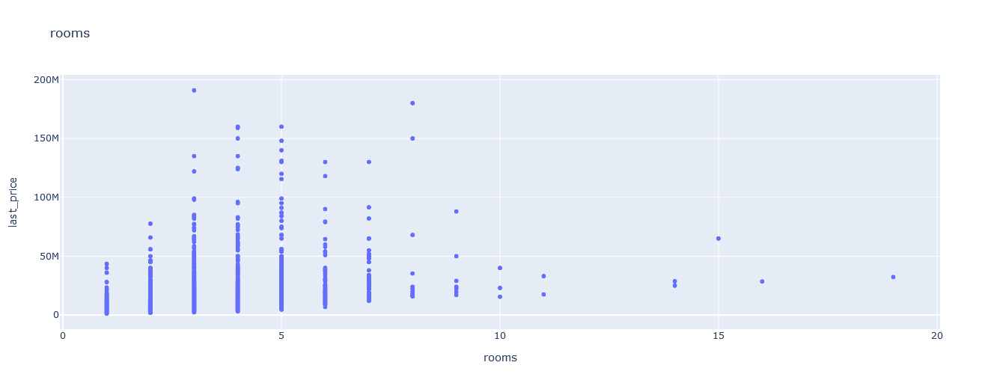

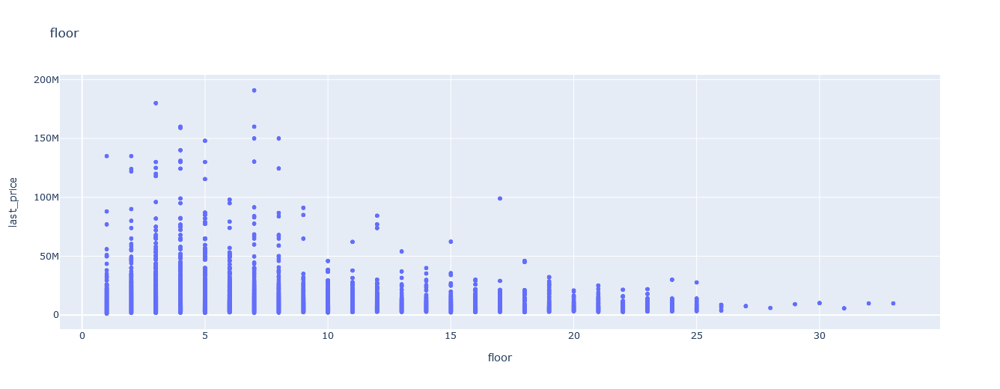

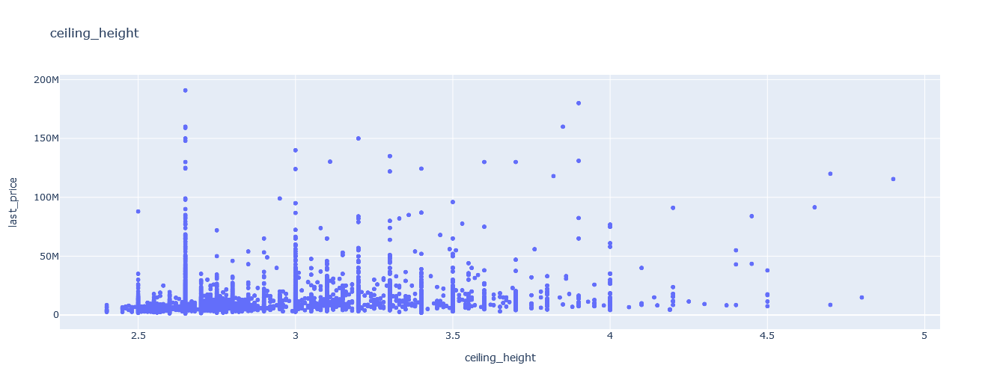

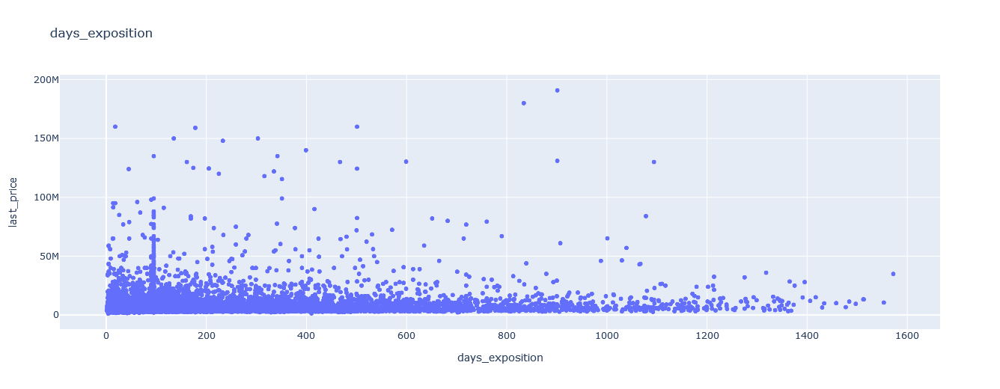

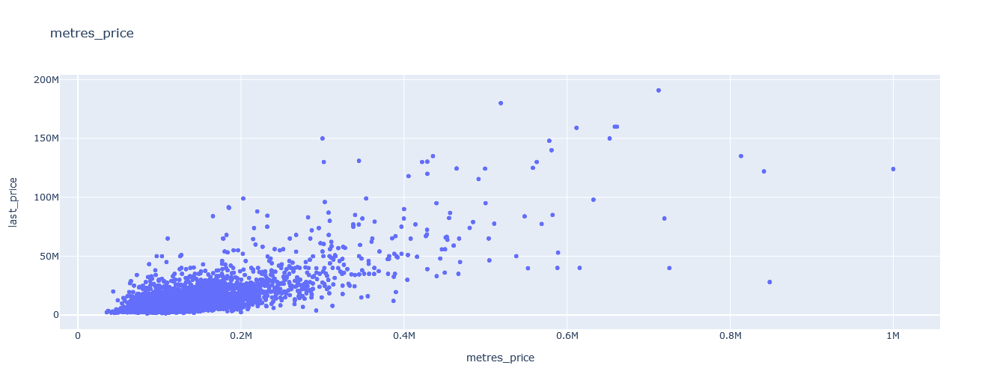

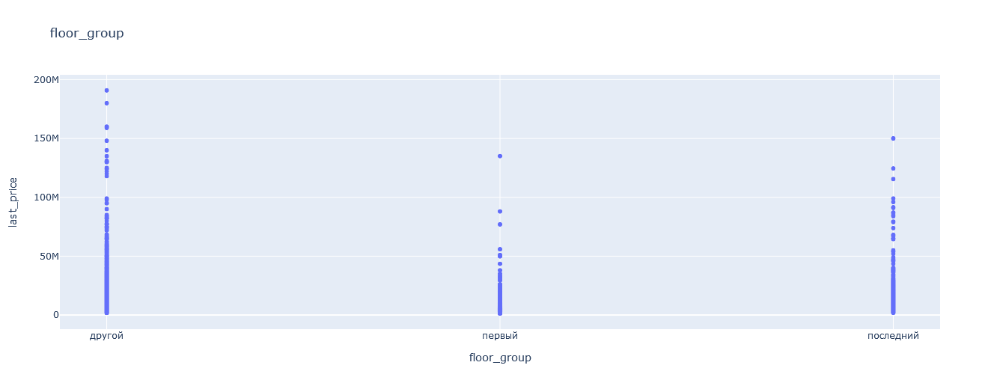

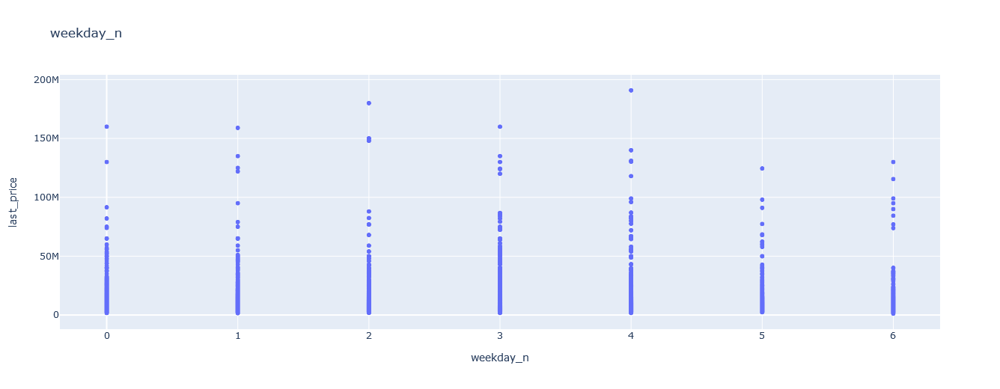

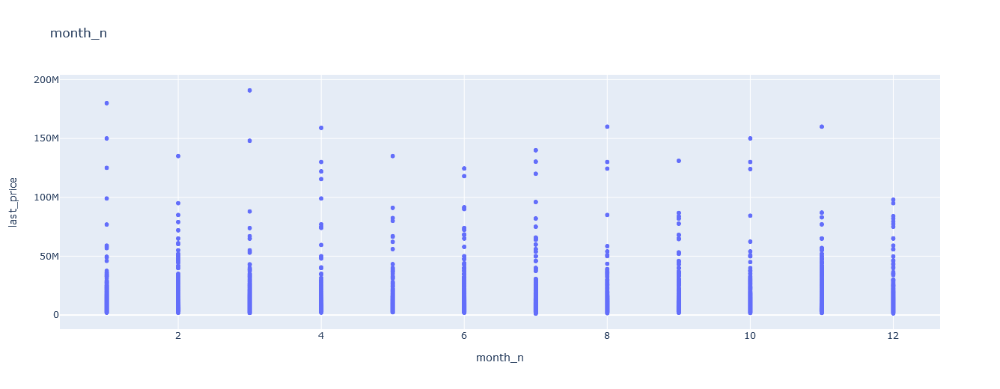

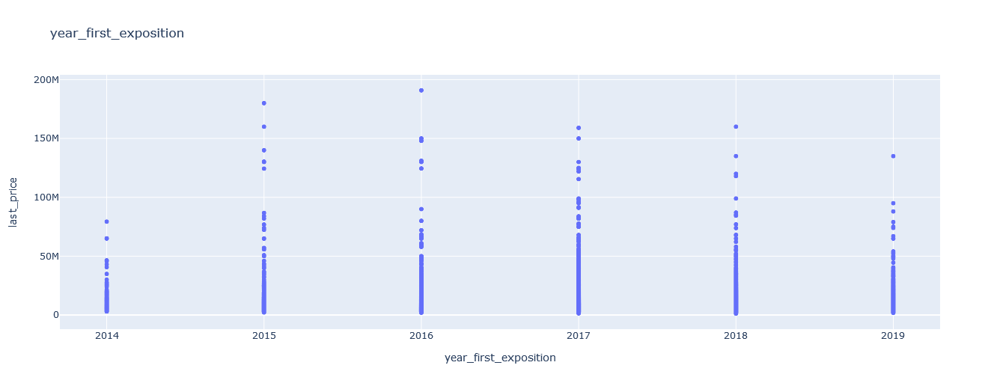

In [58]:
x_hist = st_petersburg[['total_area', 'rooms','floor', 'ceiling_height', 'days_exposition', 'metres_price', 'floor_group', 'weekday_n', 'month_n', 'year_first_exposition']]
for row in x_hist:    
    fig = px.scatter(st_petersburg, x=row, y='last_price', title=row, width=720,height=520)
    fig.show()

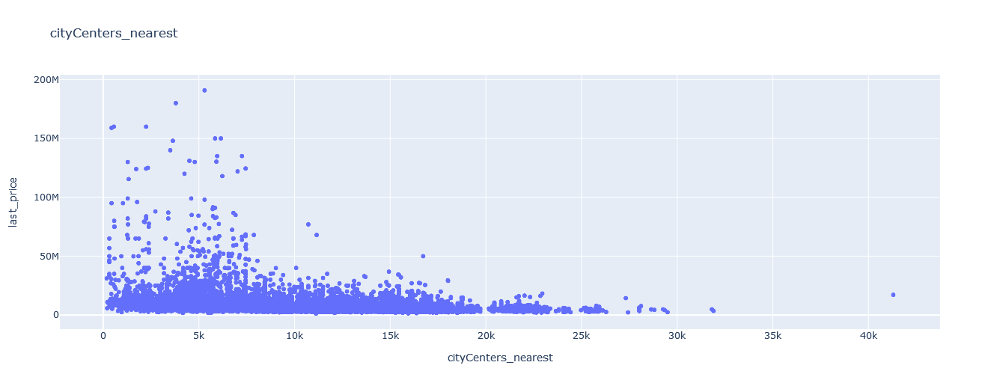

In [59]:
fig = px.scatter(st_petersburg.query('-1 < cityCenters_nearest'), x='cityCenters_nearest', y='last_price', title='cityCenters_nearest', width=720,height=520)
fig.show()

### Вывод

- ##### Объекты в городе.
Здесь все предыдущие зависимости сохраняются, цена квадратного метра, общая площадь, расстояние до центра и этаж объекта всё так же влияют на\
финальное ценообразование объекта. Чем больше общая площадь и цена за метр квадратный - тем выше цена объекта. Расстояние до центра показывает, что ближе\
к центру объектов дороже обычного стака становится больше.

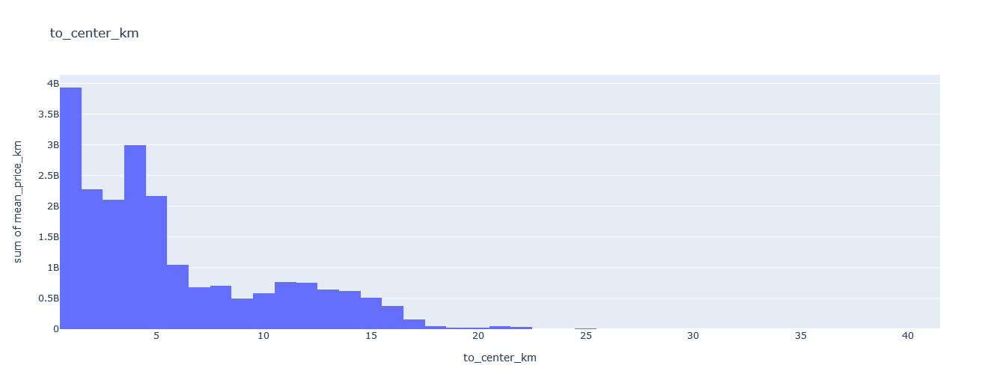

In [60]:
fig = px.histogram(st_petersburg.query('-1 < to_center_km'), y='mean_price_km', x='to_center_km', title='to_center_km', width=720,height=520)
fig.show()

In [61]:
st_petersburg_center = st_petersburg.query('to_center_km < 5')

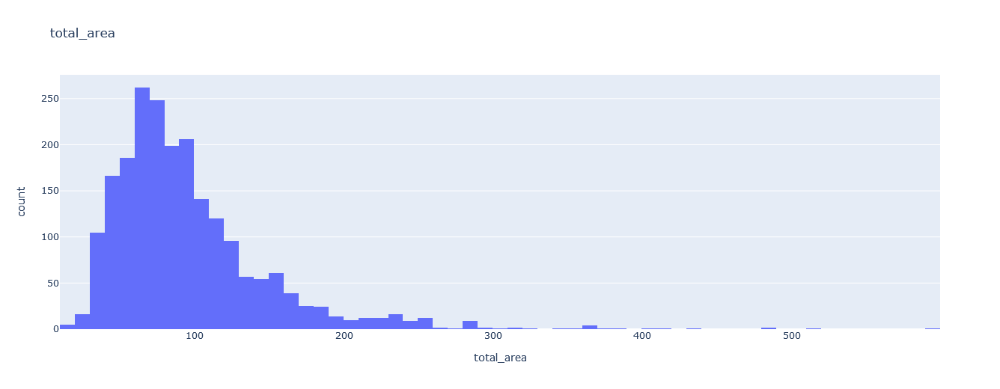

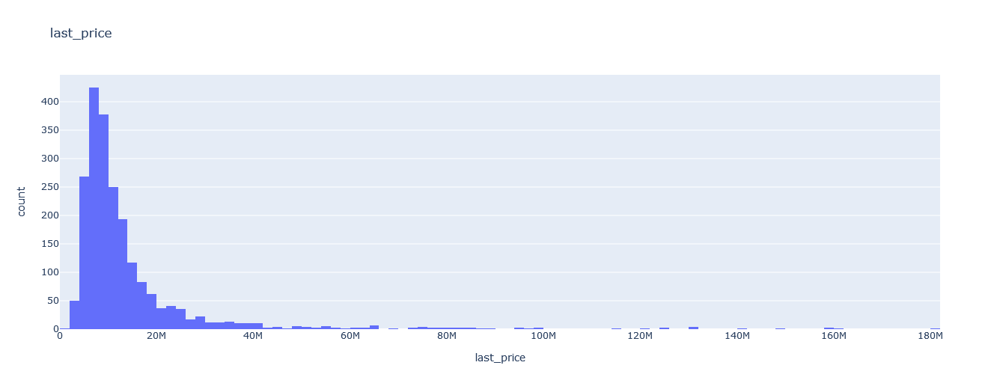

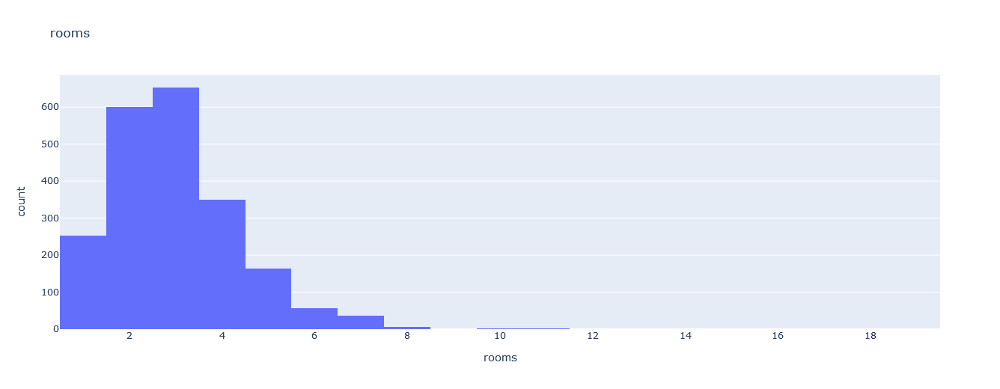

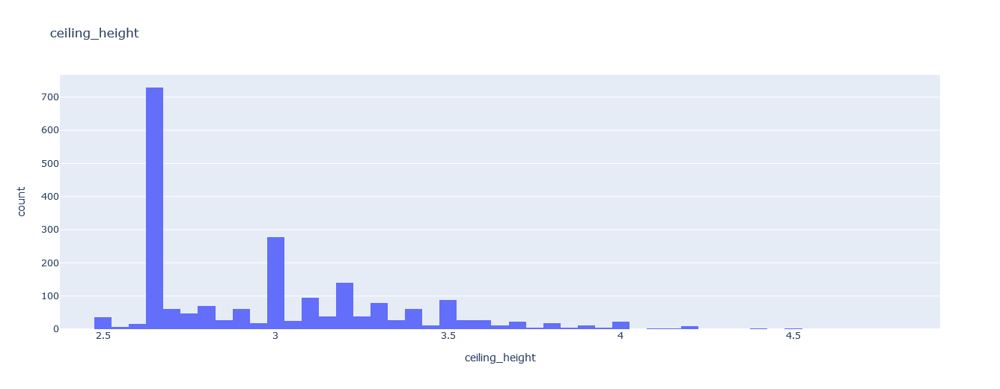

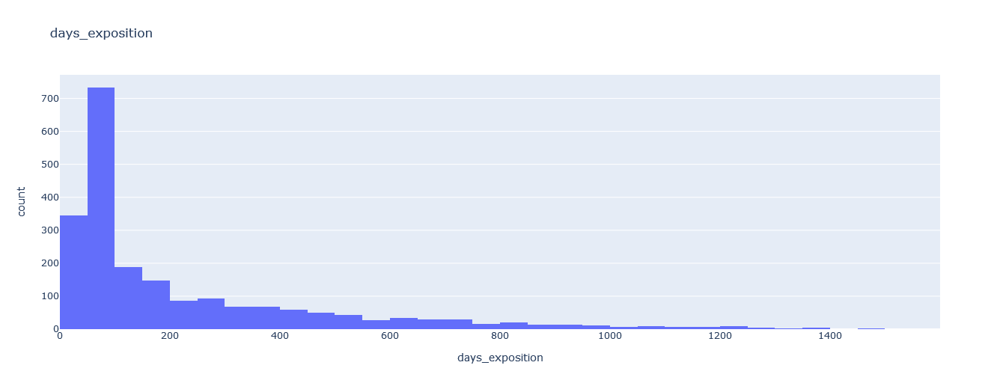

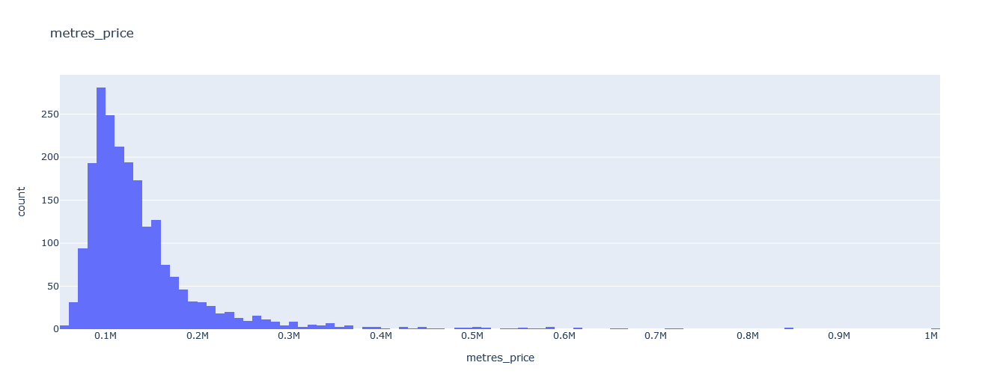

In [62]:
for row in hist_columns:
    fig = px.histogram(st_petersburg_center, x=row, title=row, width=720, height=520)
    fig.show()

#### Вывод

- ##### Зависимость в центре
Сейчас мы работаем по объектам в центре. Можно увидеть, что появились объекты дороже обычного. В остальном критерии примерно равны по значениям\
общим критериям по всему городу.

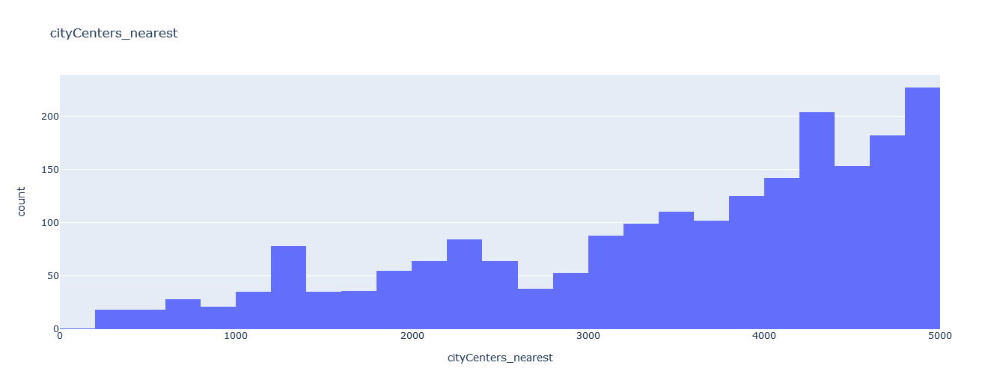

In [63]:
fig = px.histogram(st_petersburg_center.query('-1 < cityCenters_nearest'), x='cityCenters_nearest', title='cityCenters_nearest', width=720,height=520)
fig.show()

- ##### Объекты в центре
Несомненно объекты в центре и объекты за его пределом будут отличаться по цене за кв. м. и приближенности к самому центру города.\
Это совершенно, на мой взгляд, нормальная закономерность и чем дальше будут отдалятся объекты от центра, тем меньше, скорее всего,\
будет финальный ценник. Ведь зачастую центр куда более развитей пригорода и более удобный для "жизни в ритме".\
На финальную стоимость объекта сильно влияют цена за кв. м. и расстояние до центра, уже меньшую роль занимает высота потолков,\
обычно они не выбиваются из средней высоты в 2.7 м. от пола и точно так же с высотой здания и этажом, на котором расположен объекта.\

In [64]:
center_hist = st_petersburg_center[['rooms', 'floor', 'metres_price', 'to_center_km', 'ceiling_height', 'first_day_exposition']]

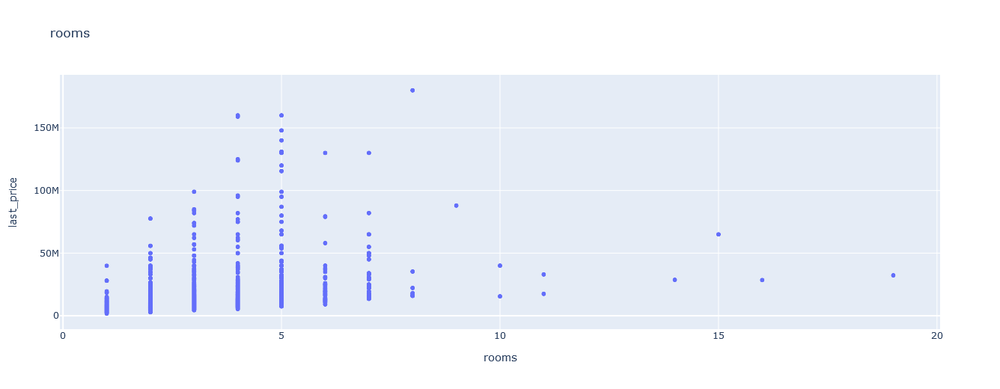

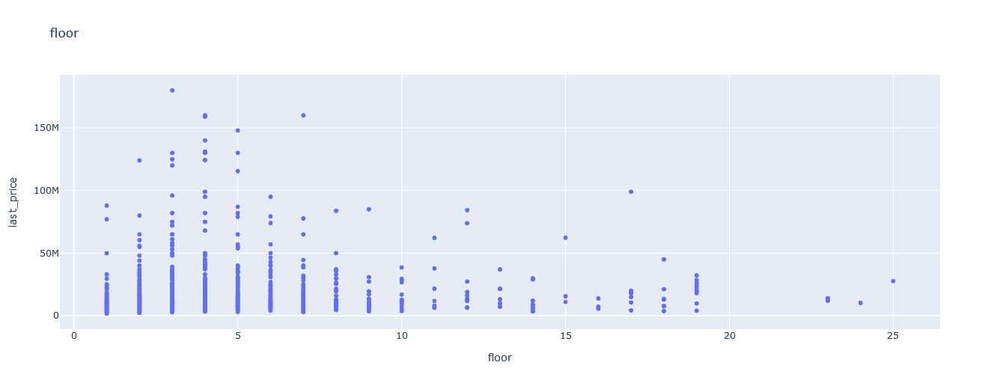

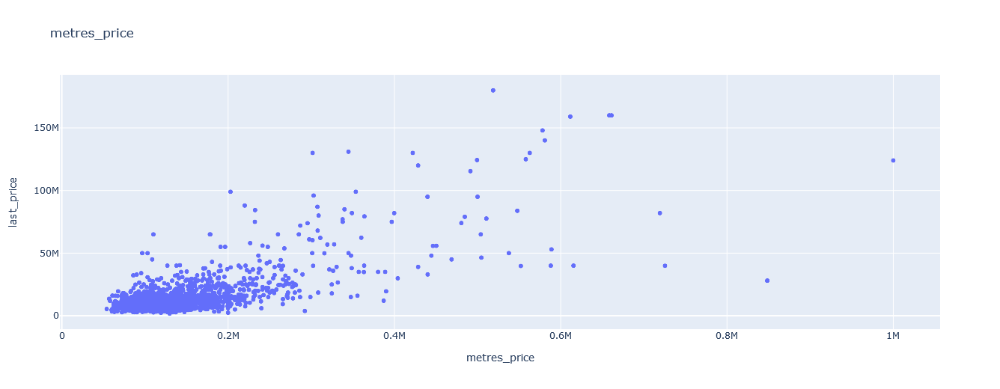

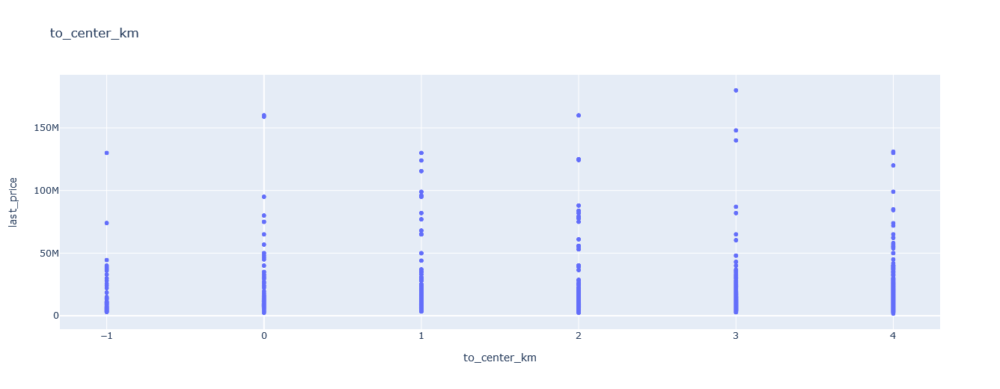

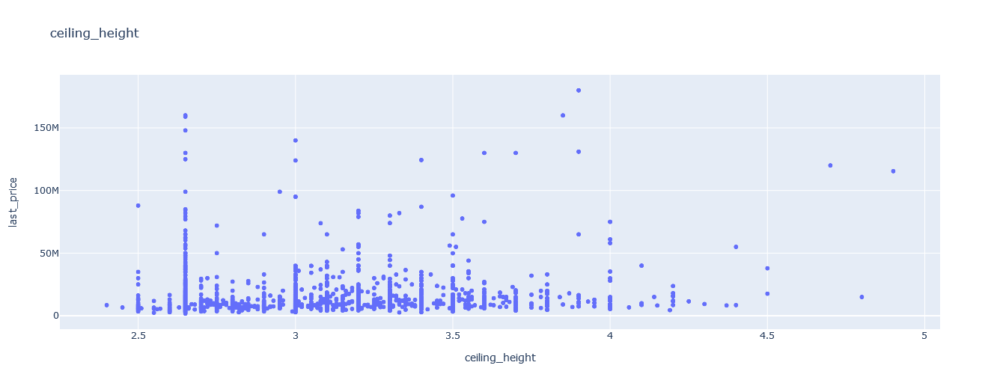

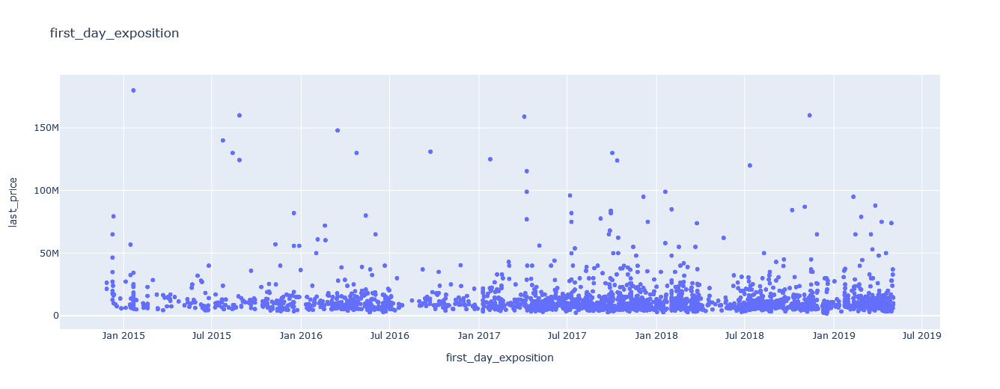

In [65]:
for row in center_hist:
    fig = px.scatter(st_petersburg_center, x=row, y='last_price', title=row, width=720, height=520)
    fig.show()

In [66]:
def center_func(row):
    if row['to_center_km'] < 5:
        return 'center'
    else:
        return 'city'

In [67]:
st_petersburg['center'] = st_petersburg.apply(center_func, axis=1)

<ipython-input-67-d6d8d04b8bed>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [68]:
city_corr = st_petersburg[['rooms', 'floor', 'metres_price', 'to_center_km', 'ceiling_height', 'year_first_exposition']]

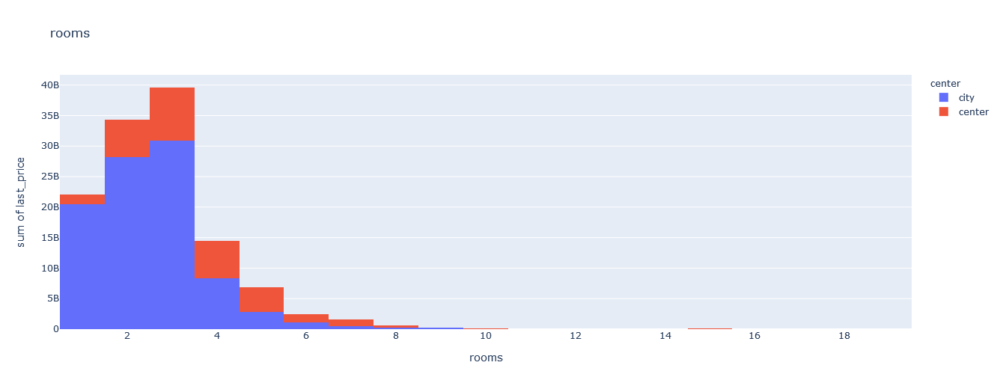

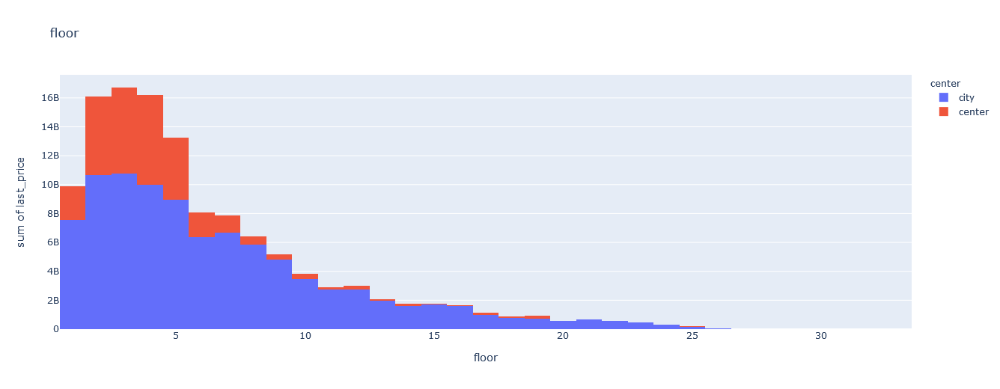

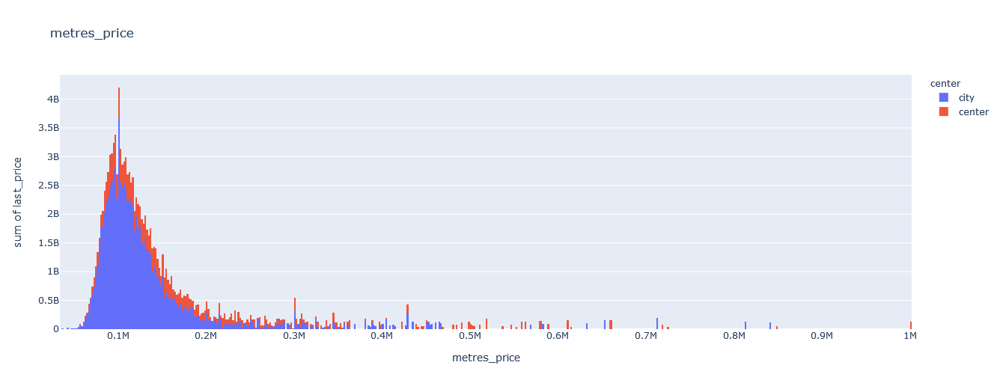

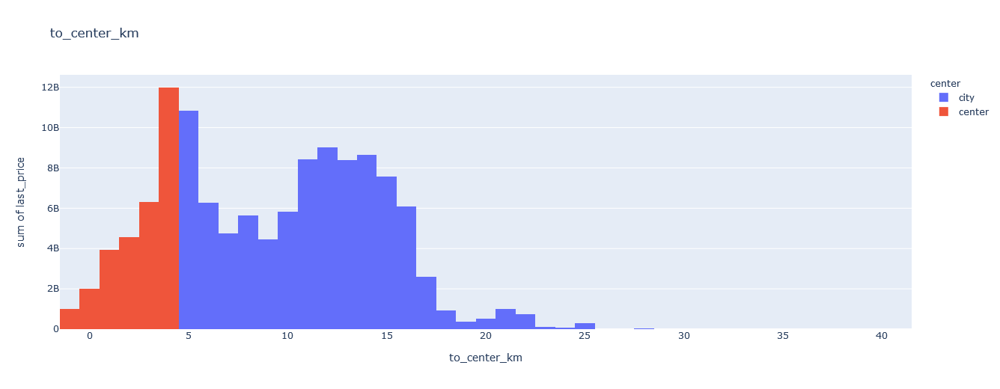

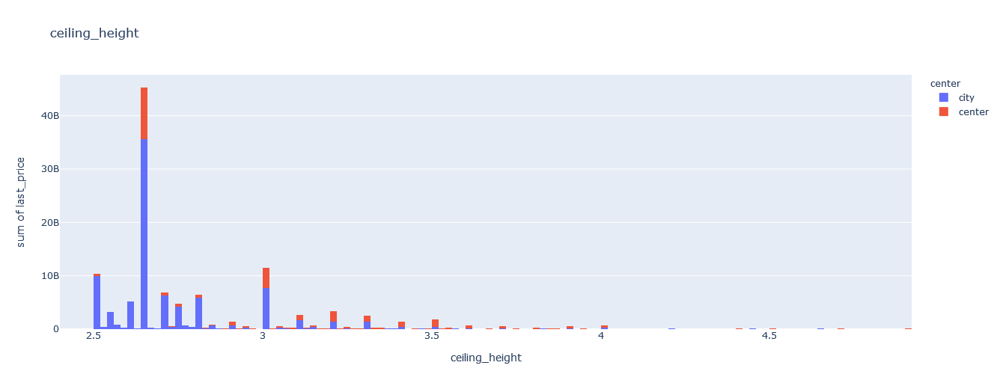

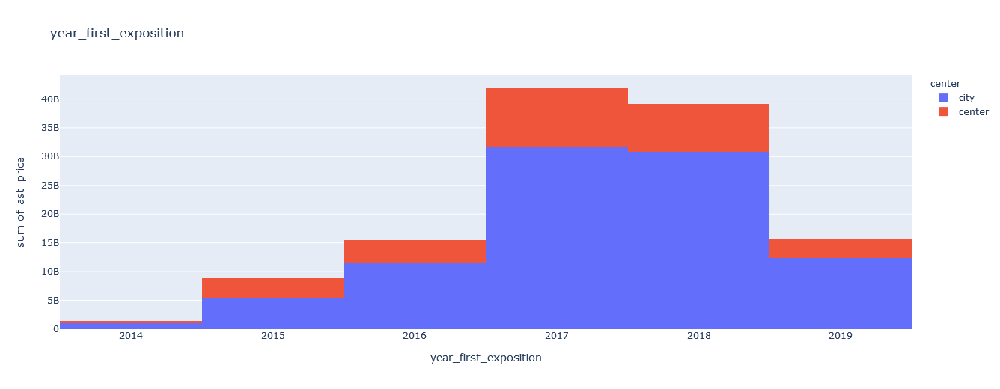

In [69]:
for row in city_corr:
    fig = px.histogram(st_petersburg, x=row, y="last_price", color="center", title=row, hover_data=st_petersburg_center, width=720, height=520)
    fig.show()

In [70]:
print('Весь город')
for row in city_corr:
    print(row, st_petersburg[row].corr(st_petersburg['last_price']))

Весь город
rooms 0.45054350909353585
floor -0.01382599435464454
metres_price 0.7442023401180986
to_center_km -0.3381206561896996
ceiling_height 0.35673321453396006
year_first_exposition -0.06197202238968577


In [71]:
print('Центр')
for row in city_corr:
    print(row, st_petersburg_center[row].corr(st_petersburg_center['last_price']))

Центр
rooms 0.36171280644594495
floor 0.12726522388317132
metres_price 0.7239298302788456
to_center_km -0.10464605298946371
ceiling_height 0.1554915388250647
year_first_exposition -0.051386523697378554


### Вывод

- ##### Объекты в центре
Несомненно объекты в центре и объекты за его пределом будут отличаться по цене за кв. м. и приближенности к самому центру города.\
Это совершенно, на мой взгляд, нормальная закономерность и чем дальше будут отдалятся объекты от центра, тем меньше, скорее всего,\
будет финальный ценник. Ведь зачастую центр куда более развитей пригорода и более удобный для "жизни в ритме".\
На финальную стоимость объекта сильно влияют цена за кв. м. и расстояние до центра, уже меньшую роль занимает высота потолков,\
обычно они не выбиваются из средней высоты в 2.7 м. от пола и точно так же с высотой здания и этажом, на котором расположен объекта.\

### Шаг 5. Общий вывод

Мы потеряли много данных в столбцах с растояниями до, обычно, важных мест для учета финальной стоимости объекта.\
Как показало исследования - те данные, что у нас остались помогли разобраться с описаными вопросами о ценообразовании рынка,\
где фаворитами вышли расстояние до центра и цена за квадратный метр. Так же удалось доказать, что центр "дороже" пригорода,\
ценник как финальный, так и за квадратный метр растёт с каждым километром приближаясь к центру и становится меньше ближе к пригороду.